In [241]:
# import libraries
import pandas as pd
import geopandas as gpd 
import json 
from traclus import traclus as tr
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import contextily as ctx
from shapely.geometry import LineString

In [242]:
# Variables globales
nrows = 300
# Ruta del archivo CSV
filename = "../train_data/taxis_trajectory/train.csv"

In [243]:
# Leer el archivo CSV
df = pd.read_csv(filename, nrows=nrows, sep=",", low_memory=False)

In [244]:
# Convertir las polilíneas de JSON a listas de coordenadas
df['POLYLINE'] = df['POLYLINE'].apply(lambda x: json.loads(x) if pd.notnull(x) else None)

# Filtrar filas con polilíneas vacías o nulas
df = df[df['POLYLINE'].apply(lambda x: x is not None and len(x) > 0)]

In [245]:
# Preparar las trayectorias para TRACLUS
trayectorias = [np.array(polyline) for polyline in df['POLYLINE']]

100 filas de datos son 2 minutos y 45 segundos,
200 filas de datos son 10 minutos y 15 segundos,
300 filas de datos son 33 minutos y 4 segundos

In [246]:
# Ejecutar TRACLUS
out = tr.traclus(trayectorias, min_samples=5, progress_bar=True)
partitions, segments, dist_matrix, clusters, cluster_assignments, representative_trajectories = out

Partitioning trajectories...
Trajectory 4/300

c:\Users\Álvaro\AppData\Local\Programs\Python\Python311\Lib\site-packages\traclus\traclus.py:255: RuntimeWarning: divide by zero encountered in log2
  LH += np.log2(d_euclidean(trajectory[i], trajectory[i+1]))


Trajectory 193/300

c:\Users\Álvaro\AppData\Local\Programs\Python\Python311\Lib\site-packages\traclus\traclus.py:218: RuntimeWarning: divide by zero encountered in scalar divide
  tan_theta0 = (shorter_slope - longer_slope) / (1 + shorter_slope * longer_slope)


Trajectory 300/300
Converting partitioned trajectories to segments...
Grouping partitions...: 1/3310

Getting representative trajectories...



c:\Users\Álvaro\AppData\Local\Programs\Python\Python311\Lib\site-packages\traclus\traclus.py:449: UserWarning: WARNING: No representative points were found.
  warnings.warn("WARNING: No representative points were found.")


In [247]:
counter1 = 0
cluster_trayectories = []
# Representacion de las trayectorias pero sin el primer elemento, este parece ser solo un conjunto basura
representative_clusters = representative_trajectories[1:representative_trajectories.__len__()]

# Trayectorias de los clusters en una lista pero sin el primer elemento
for segment in clusters:
    if counter1 == 0:
        counter1 += 1
        continue
    else:
        counter1 += 1
    for part in segment:
        if isinstance(part, np.ndarray):    
            cluster_trayectories.append(part)

In [248]:
""" trayectorias """

' trayectorias '

In [249]:
""" print("Particiones: ", partitions) """

' print("Particiones: ", partitions) '

In [250]:
""" print("Segmentos: ", segments) """

' print("Segmentos: ", segments) '

In [251]:
""" print("Matriz de distancias: ", dist_matrix) """

' print("Matriz de distancias: ", dist_matrix) '

In [252]:
""" print("Clusters: ", clusters) """

' print("Clusters: ", clusters) '

In [253]:
""" print("Asignaciones: ", cluster_assignments) """

' print("Asignaciones: ", cluster_assignments) '

In [254]:
""" print("Trayectorias representativas: ", representative_trajectories) """

' print("Trayectorias representativas: ", representative_trajectories) '

In [255]:
def plot_segments_on_map(segments, cluster_assignments, descart_minun_one=False, leyenda=False):
    # Crear un GeoDataFrame vacío
    gdf = gpd.GeoDataFrame(columns=['geometry', 'cluster_id'])

    # Añadir cada segmento al GeoDataFrame
    for segment, cluster_id in zip(segments , cluster_assignments):
        if descart_minun_one and cluster_id == -1:
            continue
            # Cada 'part' es un segmento dentro del cluster
        if isinstance(segment, np.ndarray):  # Verificar si 'part' es un array de NumPy
            line = LineString(segment)
            gdf = pd.concat([gdf, gpd.GeoDataFrame({'geometry': [line], 'cluster_id': [cluster_id]})], ignore_index=True)

    gdf.crs = "EPSG:4326"
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

    if not gdf.empty:
        # Generar colores para cada cluster
        unique_clusters = gdf['cluster_id'].unique()
        colormap = plt.cm.tab20
        color_dict = {cid: colormap(i / len(unique_clusters)) for i, cid in enumerate(unique_clusters)}

        # Dibujar cada segmento según su cluster_id
        for _, row in gdf.iterrows():
            color = color_dict[row['cluster_id']]
            gdf.loc[gdf.index == _, 'geometry'].plot(ax=ax, linewidth=2, color=color)

        # Añadir leyenda
        if leyenda:    
            legend_elements = [Line2D([0], [0], color=color_dict[cid], lw=2, label=f'Cluster {cid}') for cid in unique_clusters]
            ax.legend(handles=legend_elements, loc='upper left')

        ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    else:
        print("No hay datos válidos para graficar.")

    ax.set_axis_off()
    plt.show()

In [256]:
def plot_clusters_on_map(clusters, descart_minun_one=False, leyenda=False):
    # Crear un GeoDataFrame vacío
    gdf = gpd.GeoDataFrame(columns=['geometry', 'cluster_id'])

    cluster_id = 0
    # Añadir cada segmento al GeoDataFrame
    for segment in clusters:
        if descart_minun_one and cluster_id == 0:
            cluster_id +=1
            continue
        else:
            cluster_id +=1
        for part in segment:
            # Cada 'part' es un segmento dentro del cluster
            if isinstance(part, np.ndarray):  # Verificar si 'part' es un array de NumPy
                line = LineString(part)
                gdf = pd.concat([gdf, gpd.GeoDataFrame({'geometry': [line], 'cluster_id': [cluster_id]})], ignore_index=True)

    gdf.crs = "EPSG:4326"
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

    if not gdf.empty:
        # Generar colores para cada cluster
        unique_clusters = gdf['cluster_id'].unique()
        colormap = plt.cm.tab20
        color_dict = {cid: colormap(i / len(unique_clusters)) for i, cid in enumerate(unique_clusters)}

        # Dibujar cada segmento según su cluster_id
        for _, row in gdf.iterrows():
            color = color_dict[row['cluster_id']]
            gdf.loc[gdf.index == _, 'geometry'].plot(ax=ax, linewidth=2, color=color)

        # Añadir leyenda   
        if leyenda:     
            legend_elements = [Line2D([0], [0], color=color_dict[cid], lw=2, label=f'Cluster {cid}') for cid in unique_clusters]
            ax.legend(handles=legend_elements, loc='upper left')
        
        ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    else:
        print("No hay datos válidos para graficar.")

    ax.set_axis_off()
    plt.show()

In [257]:
def create_gdf(data):
    valid_geometries = [LineString(x) for x in data if len(x) > 1]
    gdf = gpd.GeoDataFrame(geometry=valid_geometries, crs='EPSG:4326')

    return gdf

In [258]:
def plot_map(data, color, data2=None, color2=None):
    # Crear GeoDataFrame
    gdf = create_gdf(data)
    if data2 is not None:
        gdf2 = create_gdf(data2)
    else:
        gdf2 = None

    # Visualizar en un mapa
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
    if gdf2 is not None:
        gdf2.plot(ax=ax, color=color2, alpha=0.5, linewidth=1)
    gdf.plot(ax=ax, color=color, linewidth=2)
    
    # Añadir mapa base
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    # ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite)
    ax.set_axis_off()
    plt.show()

In [259]:
def plot_map_colour(data, cmap='tab20' ,data2=None, cmap2='tab20'):
    # Crear un GeoDataFrame
    gdf = create_gdf(data)
    if data2 is not None:
        gdf2 = create_gdf(data2)
    else:
        gdf2 = None

    # Visualizar en un mapa
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
    if gdf2 is not None:
        gdf2.plot(ax=ax, cmap=cmap2, alpha=0.5, linewidth=1)
    gdf.plot(ax=ax, cmap=cmap, linewidth=2)

    # Añadir mapa base
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    ax.set_axis_off()
    plt.show()

Visualizar datos en mapas

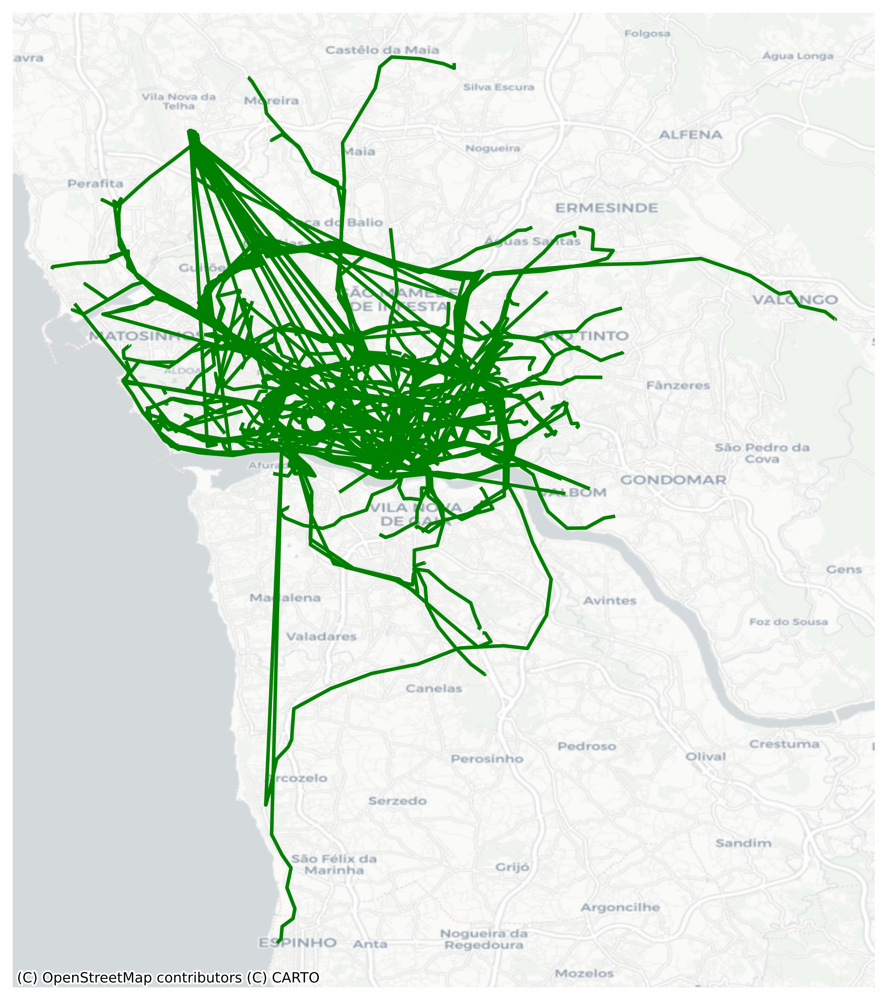

In [260]:
plot_map(partitions, 'green')

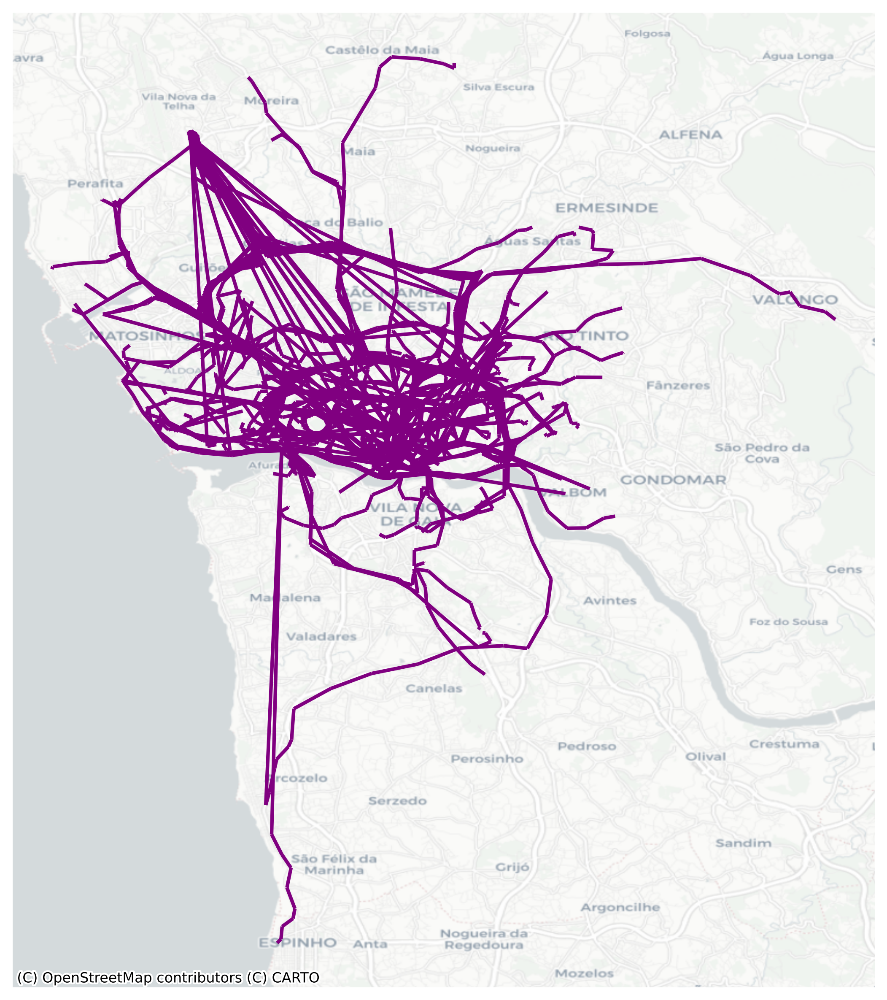

In [261]:
plot_map(segments, 'purple')

200 filas de datso son 4 minutos y 19 segundos

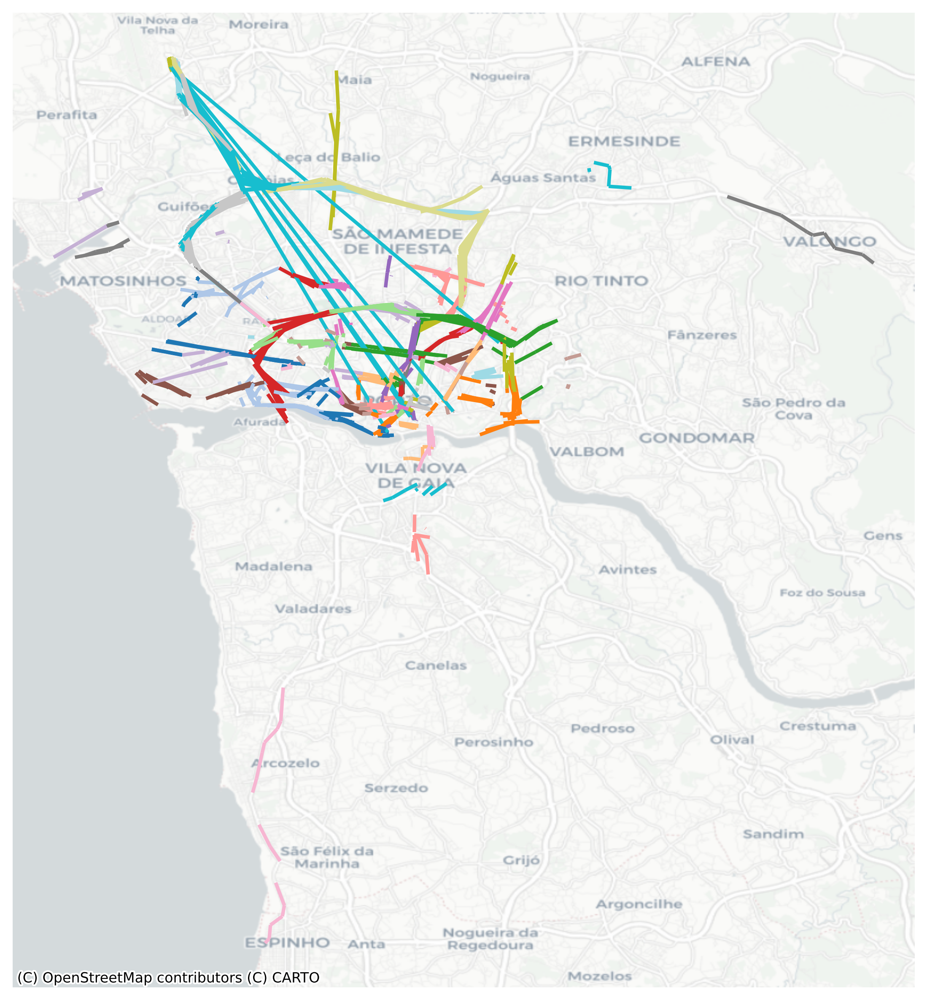

In [262]:
plot_segments_on_map(segments, cluster_assignments, descart_minun_one=True)

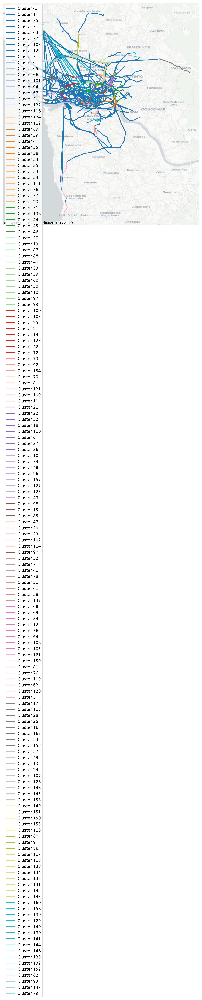

In [263]:
plot_segments_on_map(segments, cluster_assignments, leyenda=True)

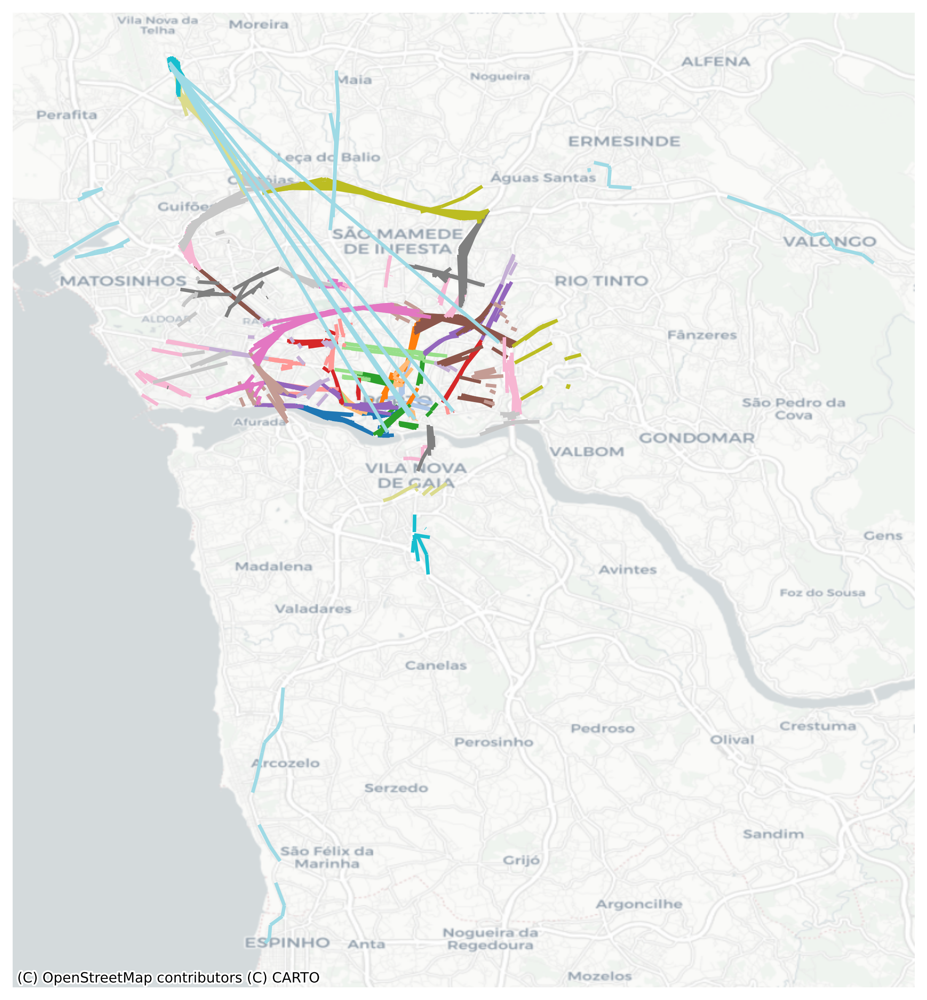

In [264]:
plot_clusters_on_map(clusters, True)

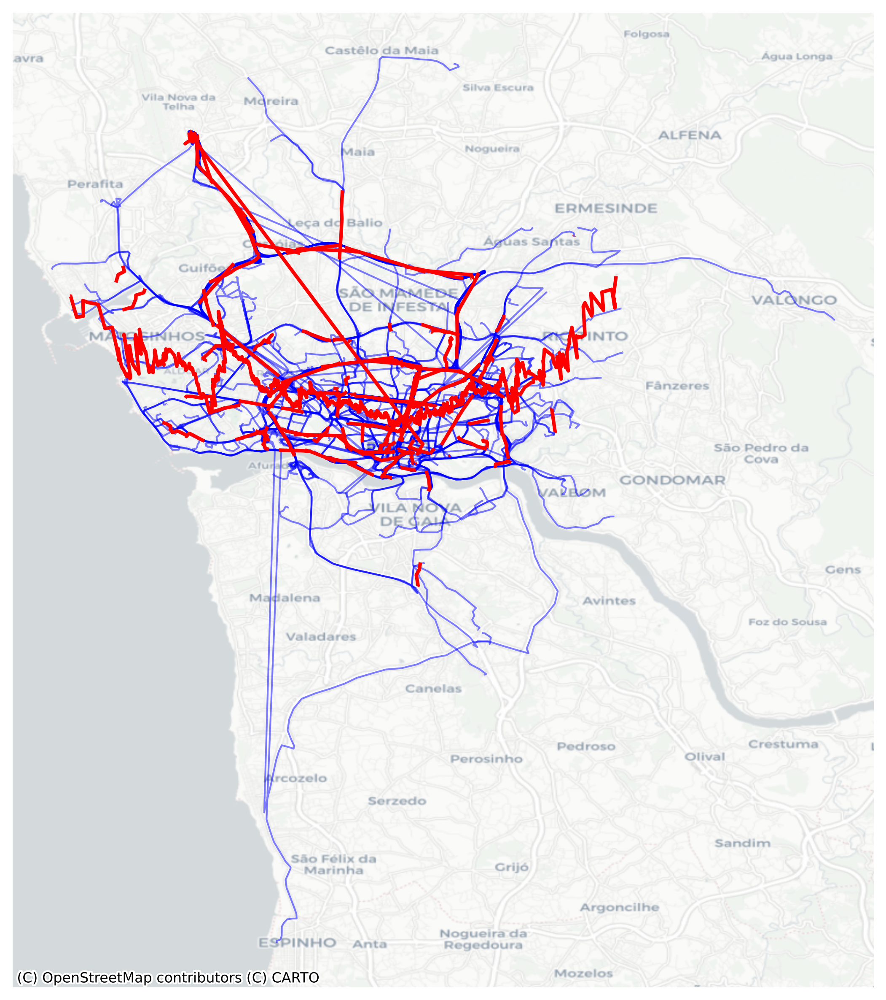

In [265]:
plot_map(representative_trajectories, 'red', df['POLYLINE'], 'blue')

Mostrar cada representacion del cluster con un color diferente

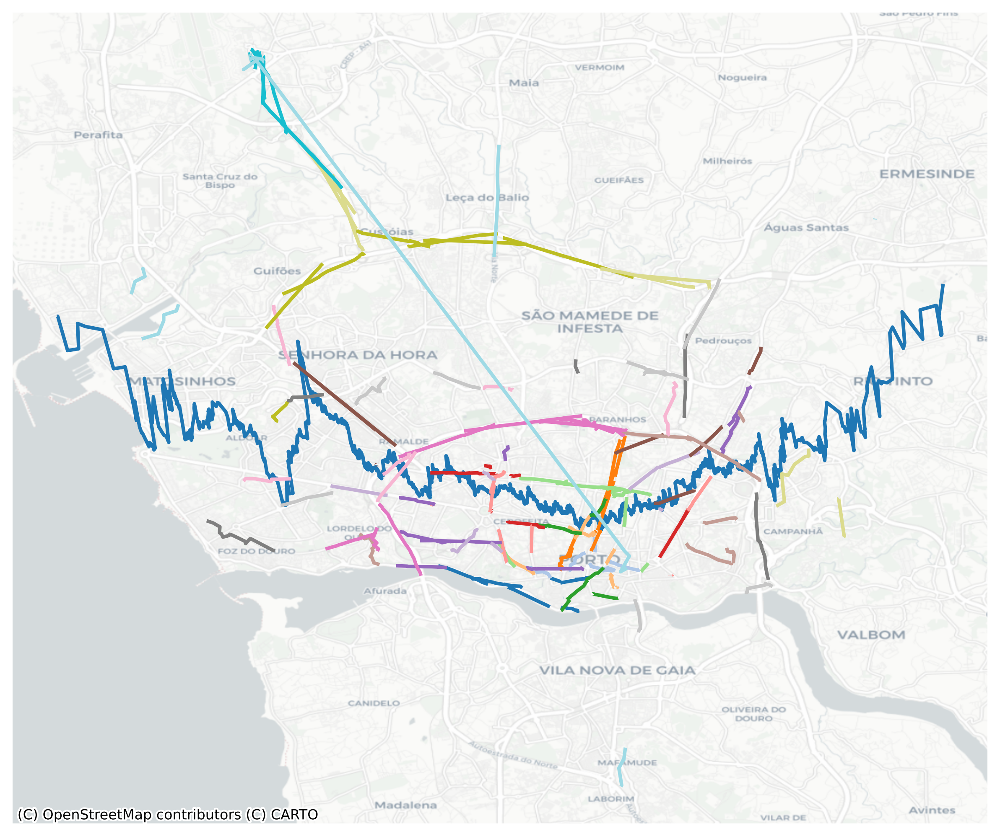

In [266]:
plot_map_colour(representative_trajectories)

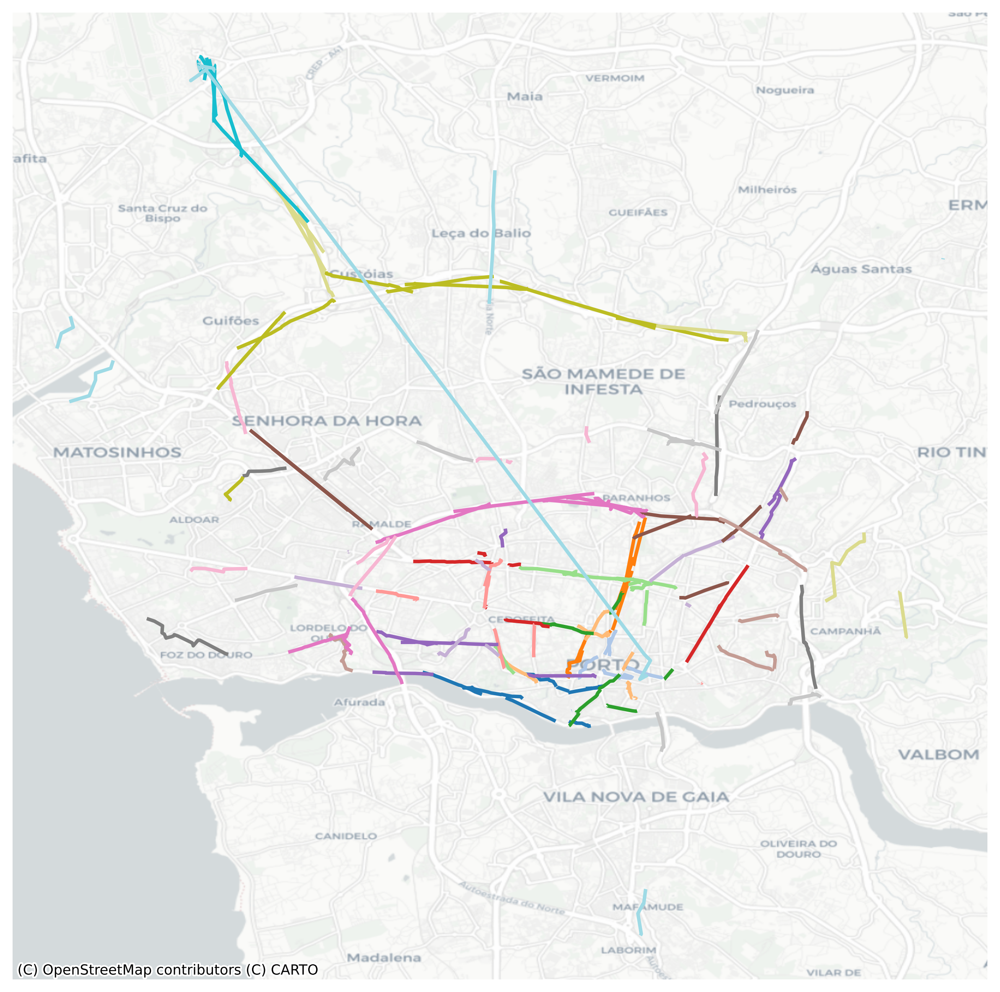

In [267]:
plot_map_colour(representative_clusters)

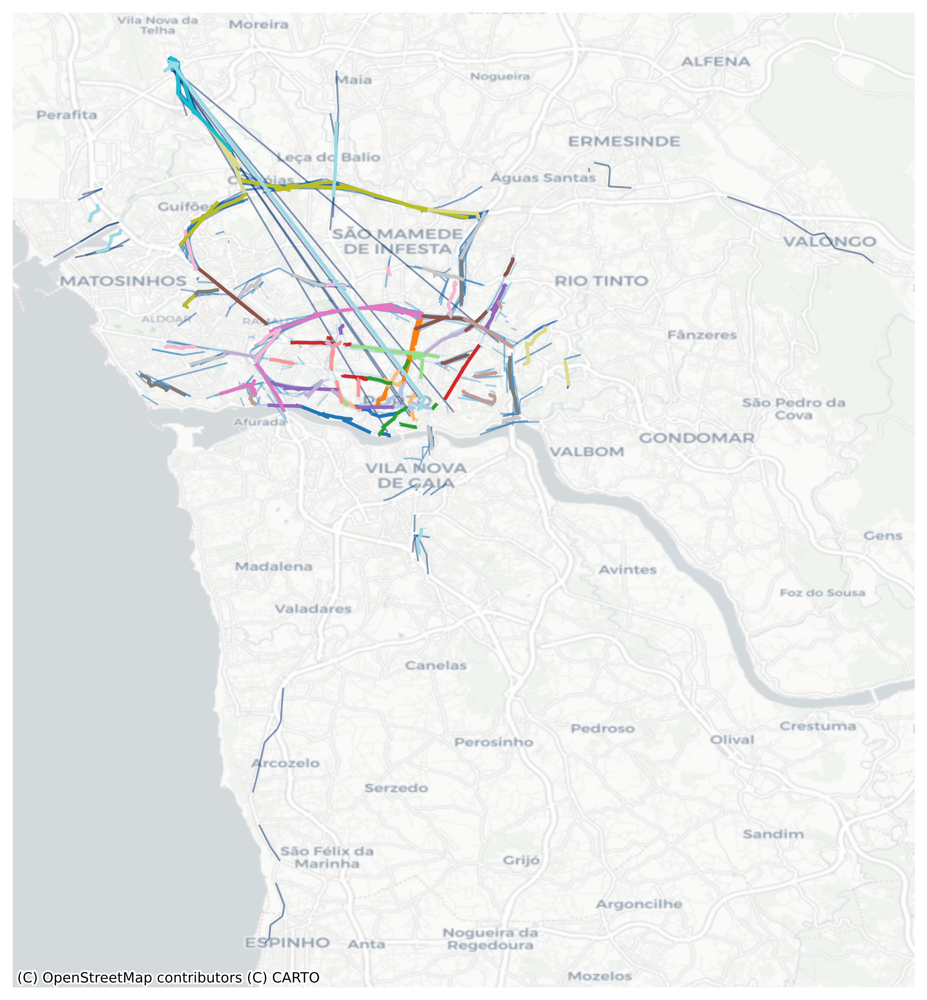

In [268]:
plot_map_colour(representative_clusters, data2=cluster_trayectories, cmap2='Blues')

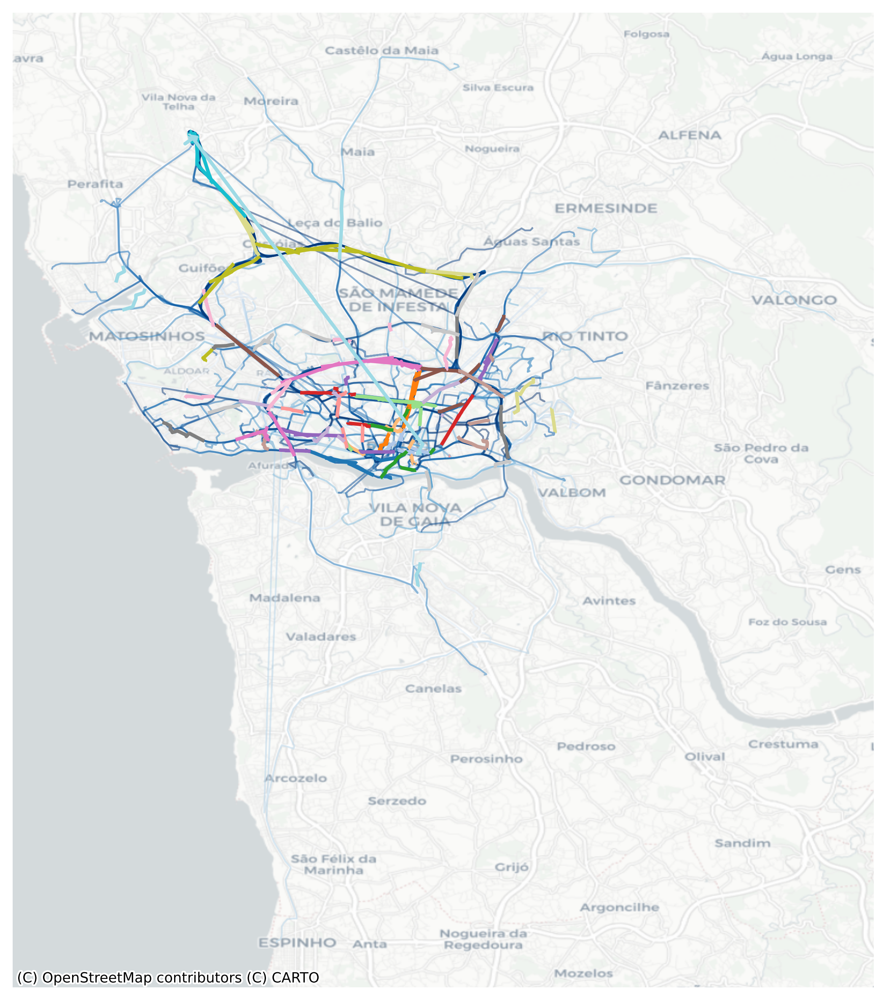

In [269]:
plot_map_colour(representative_clusters, data2=df['POLYLINE'], cmap2='Blues')

Implementacion de zoom que se puede usar

In [270]:
""" # Asegurarse de que los límites del eje se ajusten a las geometrías que estás mostrando
xmin, ymin, xmax, ymax = gdf.total_bounds
# Calcular el rango y expandirlo
xrange = xmax - xmin
yrange = ymax - ymin

# Aumentar el rango por un factor (por ejemplo, 20% más grande)
expand_factor = 100
xmin -= xrange * expand_factor
xmax += xrange * expand_factor
ymin -= yrange * expand_factor
ymax += yrange * expand_factor

# Aplicar los nuevos límites
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax) """

' # Asegurarse de que los límites del eje se ajusten a las geometrías que estás mostrando\nxmin, ymin, xmax, ymax = gdf.total_bounds\n# Calcular el rango y expandirlo\nxrange = xmax - xmin\nyrange = ymax - ymin\n\n# Aumentar el rango por un factor (por ejemplo, 20% más grande)\nexpand_factor = 100\nxmin -= xrange * expand_factor\nxmax += xrange * expand_factor\nymin -= yrange * expand_factor\nymax += yrange * expand_factor\n\n# Aplicar los nuevos límites\nax.set_xlim(xmin, xmax)\nax.set_ylim(ymin, ymax) '